## Шапка - всем шапкам шапка - добавить бизнес кэйс, название и жертв производства

#удалить перед финалом, не роботает с сгвф 12.5
#%pip install torch torchvision torchaudio
import torch

# Проверяем, доступен ли GPU
print(f"GPU доступен: {torch.cuda.is_available()}")

# Получаем имя устройства по умолчанию
print(f"Устройство по умолчанию: {torch.cuda.get_device_name(0)}")

# Проверяем версию CUDA, используемую PyTorch
print(f"CUDA версии: {torch.version.cuda}")

# Перемещаем модель на GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Проверяем, что модель использует GPU
print(f"Модель на устройстве: {next(model.parameters()).device}")

# Освобождаем видеопамять
torch.cuda.empty_cache()

# Отслеживаем использование видеопамяти
print(f"Использовано видеопамяти: {torch.cuda.memory_allocated() / 1024**2} MB")
print(f"Зарезервировано видеопамяти: {torch.cuda.memory_reserved() / 1024**2} MB")



In [2]:
import warnings
warnings.filterwarnings("ignore")

По-хорошему здесь в 2 блока собрать все библиотеки и функции - но не сегодня

и установкщики библиотек.. дописать к ним -q чтоб не забивали консоль

#### 1. Формирование неразмеченных тестовых данных

In [3]:
import os
import random
import shutil

# Пути к папкам
fire_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/fire'
non_fire_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/non fire'
smoke_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/smoke'
test_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/test'

# Создаем папку test, если ее нет
if not os.path.exists(test_dir):
    os.makedirs(test_dir)

# Функция для копирования случайных файлов из папки в test
def copy_random_files(source_dir, target_dir, max_samples):
    files = [os.path.join(source_dir, file_name) for file_name in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, file_name))]
    sampled_files = random.sample(files, min(max_samples, len(files)))
    for file_path in sampled_files:
        shutil.copy(file_path, target_dir)

# Общее количество изображений для копирования
total_samples = 1000

# Копируем случайные изображения из каждой папки в test
copy_random_files(fire_dir, test_dir, total_samples // 3)
copy_random_files(non_fire_dir, test_dir, total_samples // 3)
copy_random_files(smoke_dir, test_dir, total_samples // 3)

# Проверяем, сколько файлов скопировано
copied_files = os.listdir(test_dir)
print(f"Скопировано {len(copied_files)} изображений в папку {test_dir}")

Скопировано 2176 изображений в папку ./FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/test


### 2. Чтение заранее приготовленных данных, формирование датасетов и данных для последующей обработки

In [4]:
import os
import pandas as pd
import numpy as np
import base64
import random

# Пути к папкам test

try:
    fire_dir_test = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/fire'
except:
    fire_dir_test = "/content/drive/MyDrive/hackathon/fire/"
try: 
    non_fire_dir_test = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/non fire'
except:
    non_fire_dir_test = "/content/drive/MyDrive/hackathon/non_fire/"   
try: 
    smoke_dir_test = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/smoke'
except:
    smoke_dir_test = "/content/drive/MyDrive/hackathon/smoke/"

# Пути к папкам train
try:
    fire_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/train/fire'
except:
    fire_dir = "/content/drive/MyDrive/hackathon/fire/"
try: 
    non_fire_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/train/non fire'
except:
    non_fire_dir = "/content/drive/MyDrive/hackathon/non_fire/"   
try: 
    smoke_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/train/smoke'
except:
    smoke_dir = "/content/drive/MyDrive/hackathon/smoke/"
    
    
# Функция для загрузки изображения и его конвертации в строку base64
def load_image_as_base64(image_path):
    with open(image_path, "rb") as img_file:
        return base64.b64encode(img_file.read()).decode("utf-8")

# Сбор данных из размеченных папок
data = []

#for folder, label in [(fire_dir, "fire"), (non_fire_dir, "non_fire"), (smoke_dir, "smoke")]:
#    for file_name in os.listdir(folder):
#        file_path = os.path.join(folder, file_name)
#        if os.path.isfile(file_path):  # Проверяем, что это файл
#            image_base64 = load_image_as_base64(file_path)
#            data.append({"class": label, "image": image_base64})

# Функция для обработки папки с ограничением по количеству фото
def process_folder(data, folder, label, max_samples=1000):
    files = [os.path.join(folder, file_name) for file_name in os.listdir(folder) if os.path.isfile(os.path.join(folder, file_name))]
    # Выбираем случайные файлы, но не более max_samples
    sampled_files = random.sample(files, min(max_samples, len(files)))
    for file_path in sampled_files:
        # Загружаем изображение в формате Base64
        image_base64 = load_image_as_base64(file_path)
        # Добавляем данные в список
        data.append({"class": label, "image": image_base64})
        


# Обрабатываем каждую папку
process_folder(data, fire_dir, "fire")
process_folder(data, non_fire_dir, "non_fire")
process_folder(data, smoke_dir, "smoke")

test_data_0 = []

process_folder(test_data_0, fire_dir_test, "fire")
process_folder(test_data_0, non_fire_dir_test, "non_fire")
process_folder(test_data_0, smoke_dir_test, "smoke")

# Вывод первых нескольких элементов для проверки
for item in data[:5]:
    print(f"Class: {item['class']}, Image Length: {len(item['image'])}")

# Создание DataFrame для размеченных данных
df = pd.DataFrame(data)

# Сохранение размеченного DataFrame в CSV
try:
    df.to_csv('./hackathon/dataset.csv', index=False)
except:
    df.to_csv("/content/drive/MyDrive/hackathon/dataset.csv", index=False)
print(f"Размеченный датасет сохранен в hackathon/dataset.csv")

# Пути к папкам
try:
    test_dir = './FOREST_FIRE_SMOKE_AND_NON_FIRE_DATASET/test/test'
except:
    test_dir = "/content/drive/MyDrive/hackathon/test/test/"

print("Первые строки размеченного датасета (train):")
print(df.head())


# Сбор тестовых данных
test_data = []

# Обработка тестовой папки
for file_name in os.listdir(test_dir):
    file_path = os.path.join(test_dir, file_name)
    if os.path.isfile(file_path):  # Проверяем, что это файл
        image_base64 = load_image_as_base64(file_path)
        test_data.append({"image": image_base64})

# Создание DataFrame для тестовых данных
test_df = pd.DataFrame(test_data_0)
# Создание DataFrame для неразмеченных данных
test_df_2 = pd.DataFrame(test_data)

test_df_2['class'] = 'unmarked'

# Сохранение неразмеченного DataFrame в CSV
try:
    test_df_2.to_csv('./hackathon/test_dataset.csv', index=False)
except:
    test_df_2.to_csv("/content/drive/MyDrive/hackathon/test_dataset.csv", index=False)
    
test_df_2['class'] = 'unmarked'
print(f"Неразмеченный датасет сохранен в hackathon/test_dataset.csv")

# Печать первых строк обоих датасетов для проверки
print("Первые строки размеченного датасета (test):")
print(test_df.head())

print("\nПервые строки неразмеченного датасета (test):")
print(test_df_2.head())


Class: fire, Image Length: 40220
Class: fire, Image Length: 18288
Class: fire, Image Length: 40588
Class: fire, Image Length: 12496
Class: fire, Image Length: 5968
Размеченный датасет сохранен в hackathon/dataset.csv
Первые строки размеченного датасета (train):
  class                                              image
0  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
1  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
2  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
3  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
4  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
Неразмеченный датасет сохранен в hackathon/test_dataset.csv
Первые строки размеченного датасета (test):
  class                                              image
0  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
1  fire  /9j/2wBDAAQDAwQDAwQEAwQFBAQFBgoHBgYGBg0JCggKDw...
2  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
3  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAg

Добавить комментарии к информации ниже

In [5]:
import io
import matplotlib.pyplot as plt

def inspect_dataset(df, image_column="image", num_samples=25, cols=5):
    """
    Функция для первичного просмотра датасета с фотографиями.
    
    Параметры:
    - df: DataFrame с данными.
    - image_column: Название столбца, содержащего изображения в формате base64.
    - num_samples: Количество примеров изображений для отображения.
    - cols: Количество столбцов в сетке изображений.
    """
    print("Информация о датасете:")
    print(df.info())
    
    print("\nПервые строки датасета:")
    print(df.head())
    
    print("\nФорма датасета (строки, столбцы):")
    print(df.shape)
    
    print(f"\nПримеры изображений ({num_samples} случайных):")
    
    # Выбираем случайные образцы
    samples = df.sample(num_samples)
    
    # Вычисляем количество строк в сетке
    rows = (num_samples + cols - 1) // cols
    
    # Создаем сетку для отображения изображений
    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    fig.tight_layout(pad=0.5)
    
    # Если сетка состоит из одной строки, axes будет одномерным массивом
    if rows == 1:
        axes = axes.reshape(1, -1)
    
    # Отображаем изображения
    for i, (index, row) in enumerate(samples.iterrows()):
        image_data = base64.b64decode(row[image_column])
        image = plt.imread(io.BytesIO(image_data), format='jpeg')  # Читаем изображение с помощью matplotlib
        
        # Вычисляем индекс строки и столбца
        row_idx = i // cols
        col_idx = i % cols
        
        # Отображаем изображение
        ax = axes[row_idx, col_idx]
        ax.imshow(image)
        ax.axis("off")
        ax.set_title(f"Sample {index}")
    
    # Скрываем пустые ячейки, если изображений меньше, чем num_samples
    for i in range(num_samples, rows * cols):
        row_idx = i // cols
        col_idx = i % cols
        axes[row_idx, col_idx].axis("off")
    
    plt.show()

Информация о датасете:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   class   3000 non-null   object
 1   image   3000 non-null   object
dtypes: object(2)
memory usage: 47.0+ KB
None

Первые строки датасета:
  class                                              image
0  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
1  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
2  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
3  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
4  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...

Форма датасета (строки, столбцы):
(3000, 2)

Примеры изображений (25 случайных):


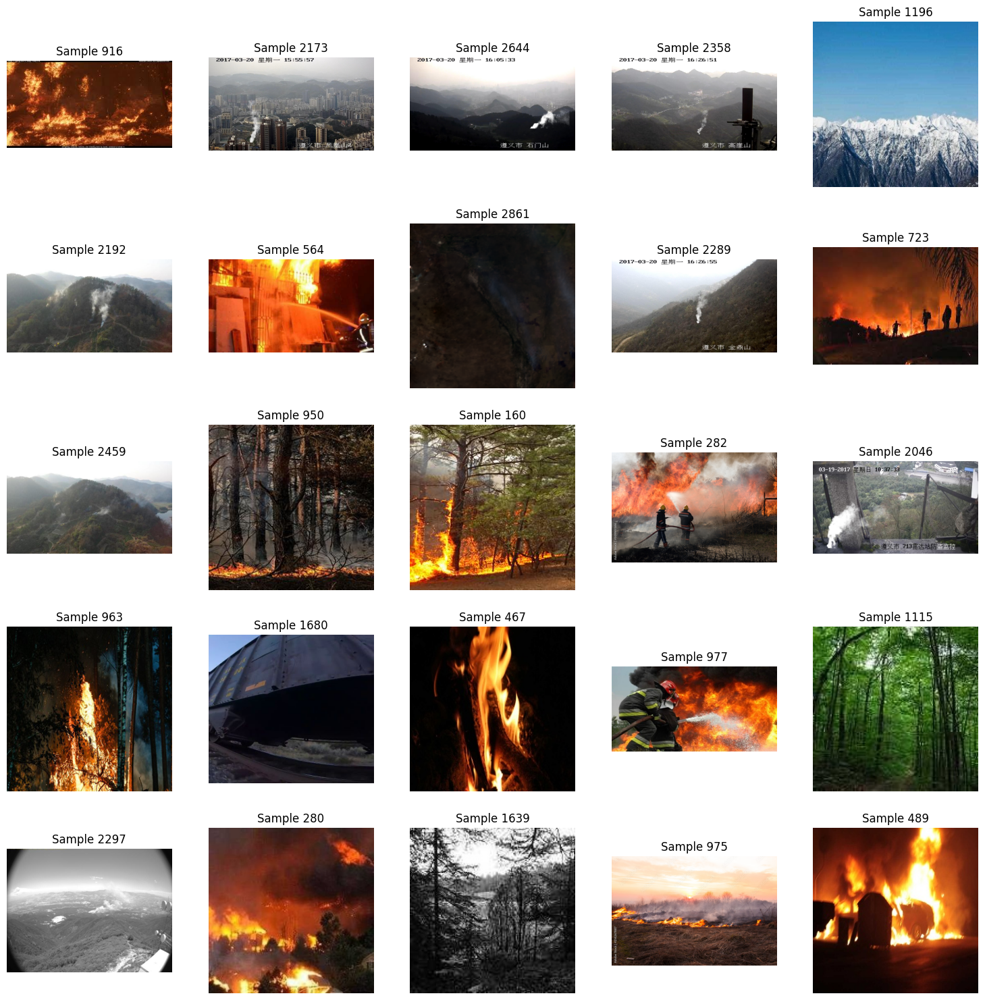

In [6]:
inspect_dataset(df)

In [7]:
df.head()

,class,image
0,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
1,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
2,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...
3,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
4,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...


Информация о датасете:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   class   3000 non-null   object
 1   image   3000 non-null   object
dtypes: object(2)
memory usage: 47.0+ KB
None

Первые строки датасета:
  class                                              image
0  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
1  fire  /9j/2wBDAAQDAwQDAwQEAwQFBAQFBgoHBgYGBg0JCggKDw...
2  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
3  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
4  fire  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...

Форма датасета (строки, столбцы):
(3000, 2)

Примеры изображений (25 случайных):


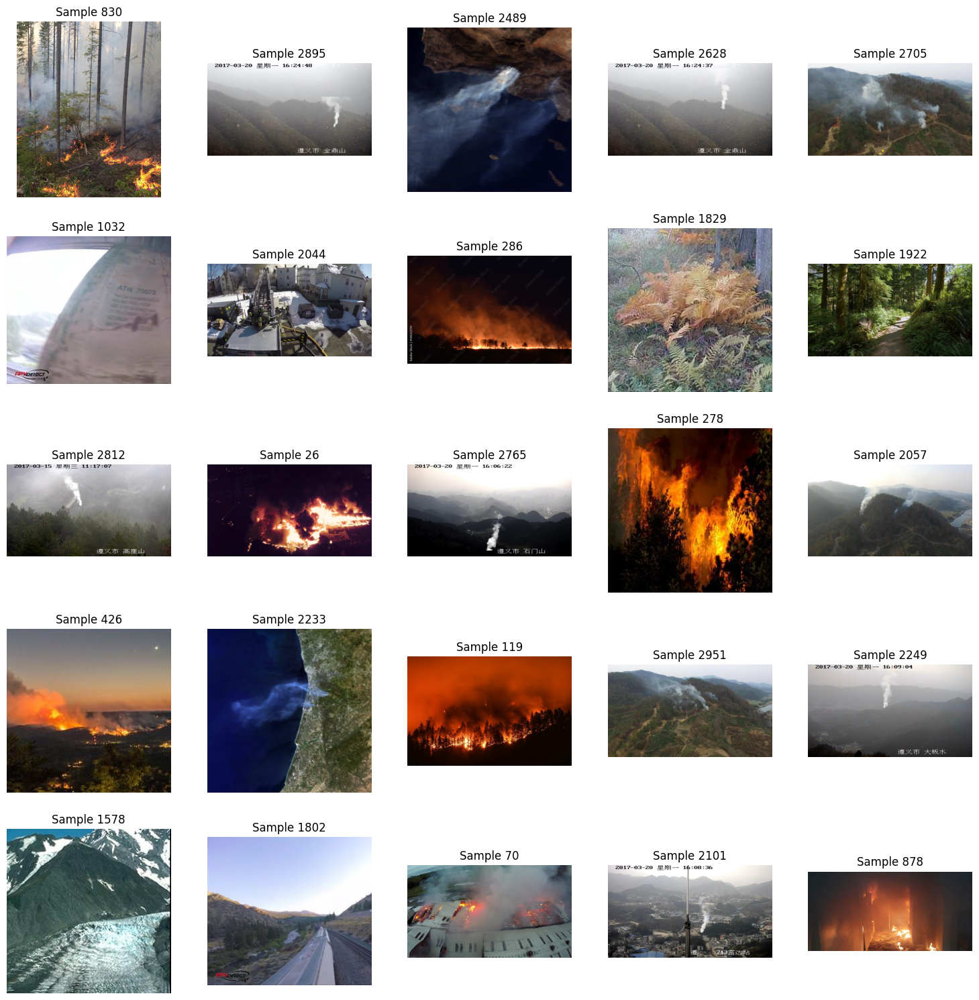

In [8]:
inspect_dataset(test_df)

In [9]:
test_df.head()

,class,image
0,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
1,fire,/9j/2wBDAAQDAwQDAwQEAwQFBAQFBgoHBgYGBg0JCggKDw...
2,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
3,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...
4,fire,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...


Информация о датасете:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2176 entries, 0 to 2175
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   2176 non-null   object
 1   class   2176 non-null   object
dtypes: object(2)
memory usage: 34.1+ KB
None

Первые строки датасета:
                                               image     class
0  /9j/4AAQSkZJRgABAgAAAQABAAD//gAQTGF2YzU3LjY0Lj...  unmarked
1  /9j/4AAQSkZJRgABAgAAAQABAAD//gAQTGF2YzU3LjY0Lj...  unmarked
2  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...  unmarked
3  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...  unmarked
4  /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...  unmarked

Форма датасета (строки, столбцы):
(2176, 2)

Примеры изображений (25 случайных):


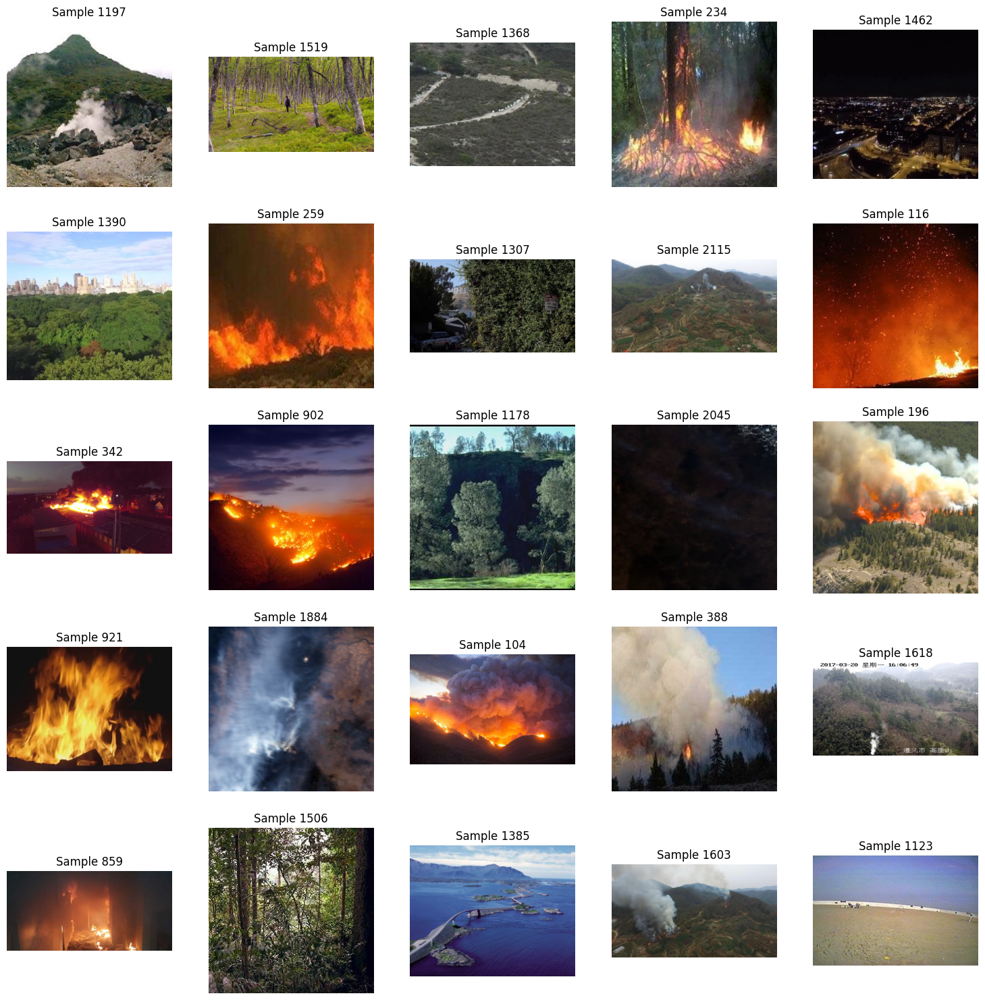

In [10]:
inspect_dataset(test_df_2)

In [11]:
test_df_2.head()

,image,class
0,/9j/4AAQSkZJRgABAgAAAQABAAD//gAQTGF2YzU3LjY0Lj...,unmarked
1,/9j/4AAQSkZJRgABAgAAAQABAAD//gAQTGF2YzU3LjY0Lj...,unmarked
2,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...,unmarked
3,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...,unmarked
4,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQ...,unmarked


In [12]:
df.shape

(3000, 2)

In [13]:
%pip install imagehash -q
#!pip install imagehash

Note: you may need to restart the kernel to use updated packages.


Проверим есть ли одинаковые изображения по гистограммам:

- проверяя дубликаты не попиксельно, а по гистограмме, можно найти не абсолютные дубликаты,а очень похожие изображения. Например кадры из одного видео.
- дублируем проверку по хэшу

In [14]:
import os
import numpy as np
import pandas as pd
from PIL import Image
import cv2
import imagehash
from tqdm import tqdm
import tempfile
import base64
from io import BytesIO

# Функция для декодирования base64 в объект PIL.Image
def decode_base64_to_image(base64_str):
    image_data = base64.b64decode(base64_str)
    return Image.open(BytesIO(image_data))

# Функция для вычисления хеша изображения
def get_image_hash(image):
    return imagehash.average_hash(image)

# Функция для вычисления гистограммы изображения
def get_image_histogram(image):
    # Конвертируем изображение в формат numpy (если это не сделано) и в grayscale
    image = image.convert('RGB')
    image_cv = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)

    # Вычисляем гистограмму
    hist = cv2.calcHist([image_cv], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

# Проверяем дубликаты по гистограмме и хэшу
def check_duplicates(df):
    image_hashes = {}
    image_histograms = {}
    duplicates = []  # Список для хранения пар индексов дубликатов
    item_to_delete = []  # Список для хранения индексов, которые нужно удалить
    duplicate_count = {}  # Счётчик количества дубликатов для каждого хэша

    for index, row in tqdm(df.iterrows(), total=len(df), desc="Processing images"):
        base64_str = row['image']

        # Декодируем изображение из base64
        image = decode_base64_to_image(base64_str)

        # Вычисляем хэш и гистограмму
        image_hash = get_image_hash(image)
        image_histogram = get_image_histogram(image)

        # Проверяем совпадение
        for saved_hash, saved_index in image_hashes.items():
            if image_hash == saved_hash:  # Сравнение по хэшу
                saved_histogram = image_histograms[saved_hash]
                hist_diff = cv2.compareHist(image_histogram, saved_histogram, cv2.HISTCMP_CORREL)

                if hist_diff > 0.95:  # Гистограммы почти одинаковые
                    duplicates.append((saved_index, index))
                    item_to_delete.append(index)
                    duplicate_count[saved_hash] = duplicate_count.get(saved_hash, 0) + 1
                    break
        else:
            # Сохраняем хэш и гистограмму
            image_hashes[image_hash] = index
            image_histograms[image_hash] = image_histogram

    return duplicates, item_to_delete, duplicate_count

# Пример использования
# df — это DataFrame с колонкой 'image', содержащей строки base64
duplicates, item_to_delete, duplicate_count = check_duplicates(df)

if duplicates:
    print("Найдены одинаковые изображения:")
    print(duplicates)

    #print("\nКоличество дубликатов для каждого изображения:")
    #for image_hash, count in duplicate_count.items():
    #    print(f"Хеш {image_hash}: {count} дубликатов")

    print("\nИндексы, которые следует удалить (дубликаты с более высоким индексом):")
    print(item_to_delete)

else:
    print("Одинаковых изображений не найдено.")


Processing images: 100%|██████████| 3000/3000 [00:42<00:00, 70.93it/s] 

Найдены одинаковые изображения:
[(71, 126), (93, 144), (56, 163), (99, 214), (54, 240), (60, 260), (19, 345), (357, 388), (173, 418), (284, 470), (97, 474), (400, 488), (48, 514), (95, 529), (38, 543), (197, 555), (498, 559), (39, 580), (145, 587), (511, 598), (24, 611), (176, 616), (199, 618), (500, 622), (51, 670), (411, 692), (537, 710), (479, 751), (662, 756), (702, 759), (741, 774), (608, 777), (668, 784), (601, 814), (150, 818), (660, 827), (38, 829), (833, 838), (168, 845), (23, 848), (171, 851), (595, 852), (284, 856), (198, 872), (387, 881), (746, 912), (746, 920), (84, 924), (797, 934), (227, 943), (471, 948), (607, 955), (907, 959), (471, 960), (355, 961), (816, 970), (696, 977), (226, 982), (265, 985), (1053, 1227), (1216, 1231), (1033, 1347), (1087, 1365), (1053, 1413), (1042, 1438), (1437, 1471), (1373, 1509), (1490, 1540), (1547, 1593), (1019, 1700), (1577, 1716), (1659, 1723), (1027, 1746), (1391, 1772), (1116, 1781), (1751, 1782), (1759, 1798), (1776, 1799), (1433, 182

In [15]:
print(f'Итого дубликатов: {len(duplicates)} или {round(len(duplicates)*100/df.shape [0],2)} %')

Итого дубликатов: 514 или 17.13 %


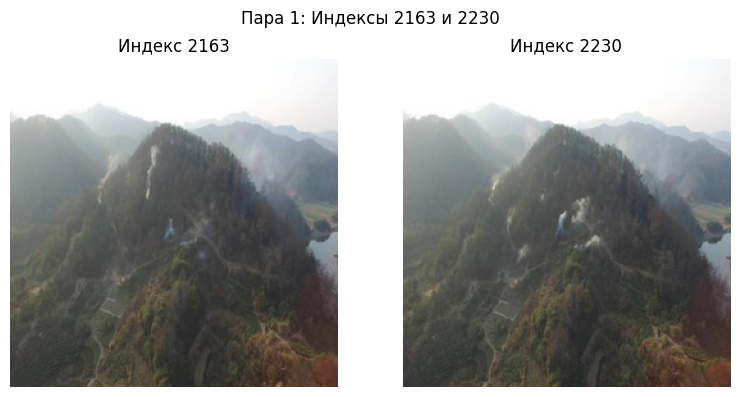

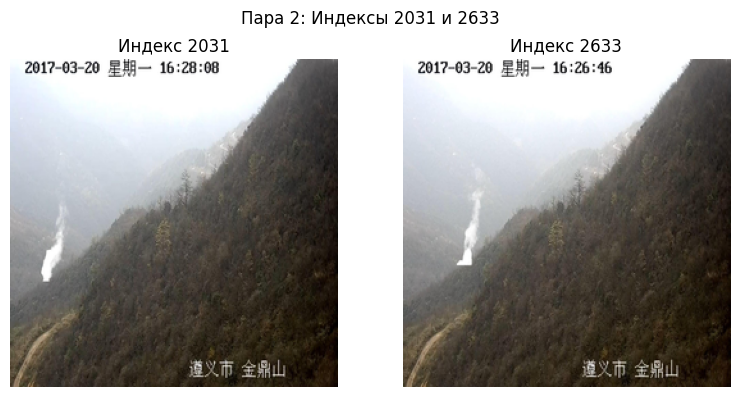

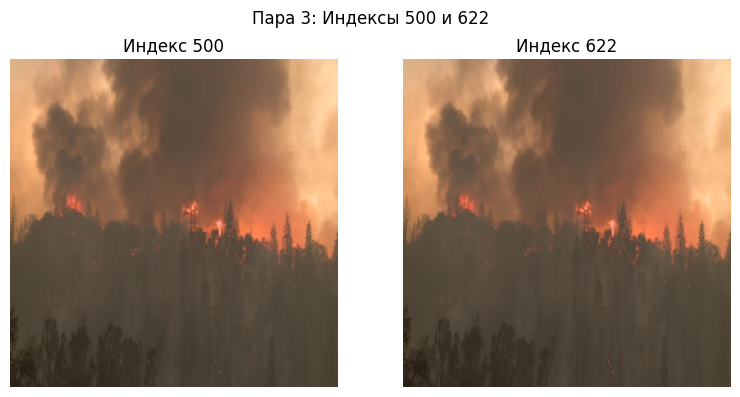

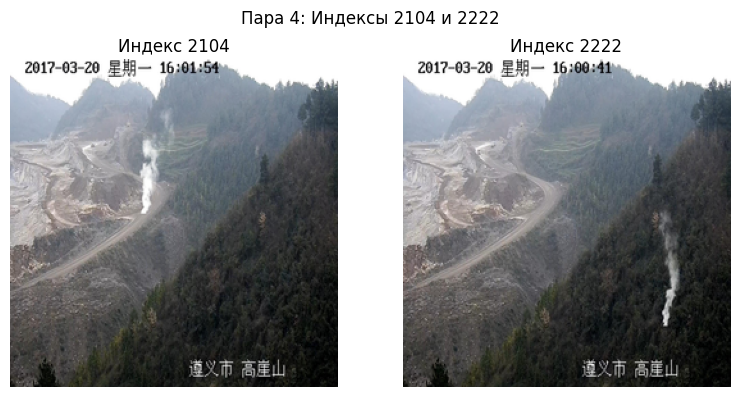

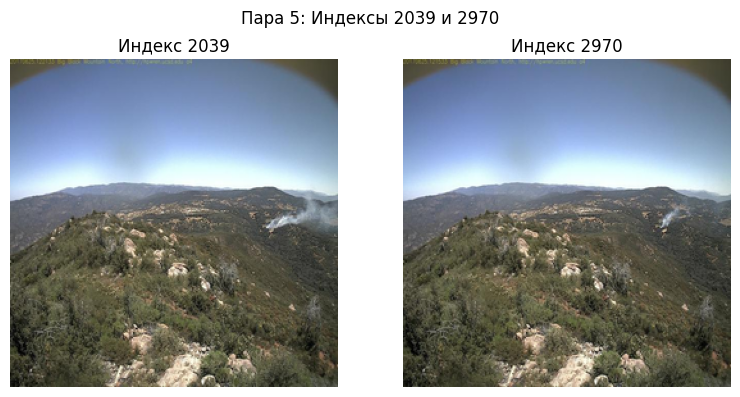

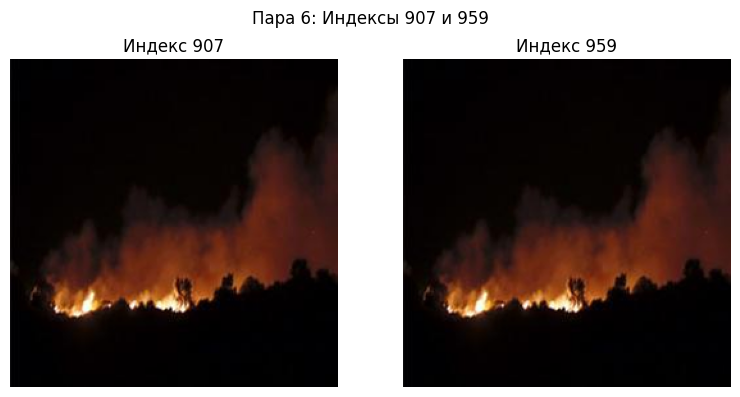

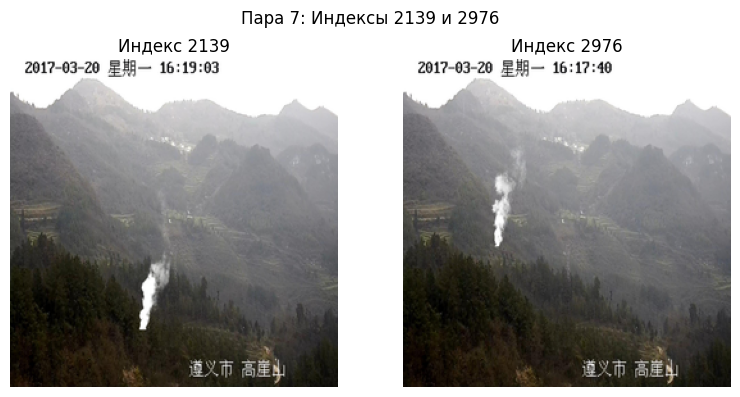

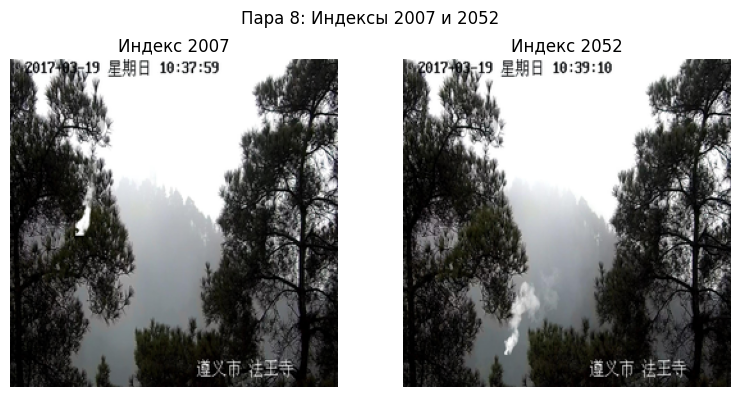

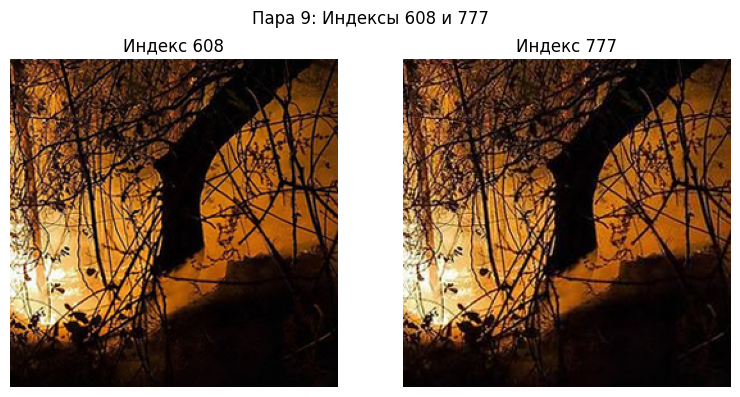

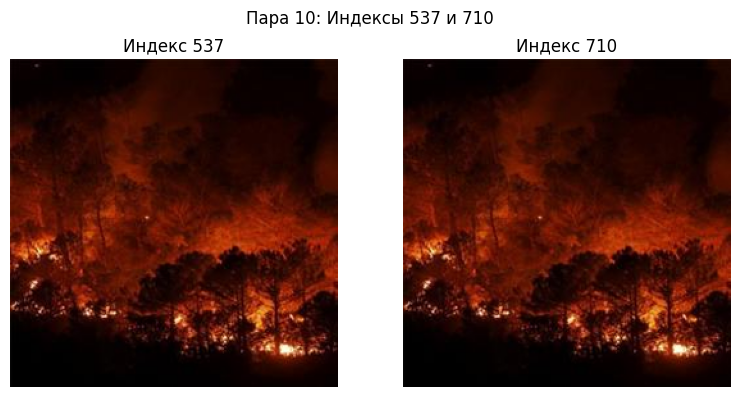

In [16]:
from PIL import Image

# Функция для декодирования base64 в объект PIL.Image
def decode_base64_to_image(base64_str, resize=None):
    """
    Декодирует строку base64 в объект PIL.Image.
    :param base64_str: Строка в формате base64.
    :param resize: Кортеж (ширина, высота) для уменьшения изображения.
    :return: Объект PIL.Image.
    """
    image_data = base64.b64decode(base64_str)
    image = Image.open(BytesIO(image_data))
    if resize:
        image = image.resize(resize, Image.Resampling.LANCZOS)  # Уменьшаем изображение
    return image

def display_image_pairs(duplicates, df, num_pairs=10, resize=None):
    """
    Случайно выбирает пары дубликатов и выводит их на экран.

    :param duplicates: Список кортежей с парами индексов дубликатов.
    :param df: DataFrame, содержащий изображения в колонке 'image'.
    :param num_pairs: Количество пар, которые нужно показать.
    :param resize: Кортеж (ширина, высота) для уменьшения изображения.
    """
    if len(duplicates) < num_pairs:
        print(f"В списке дубликатов меньше {num_pairs} пар. Будет показано {len(duplicates)} пар.")
        num_pairs = len(duplicates)

    # Случайный выбор пар
    selected_pairs = random.sample(duplicates, num_pairs)

    for i, (index1, index2) in enumerate(selected_pairs):
        # Извлекаем изображения из DataFrame и декодируем их
        image1 = decode_base64_to_image(df.loc[index1, 'image'], resize=resize)
        image2 = decode_base64_to_image(df.loc[index2, 'image'], resize=resize)

        # Отображаем изображения в 2 столбца
        fig, axes = plt.subplots(1, 2, figsize=(8, 4))
        fig.suptitle(f"Пара {i+1}: Индексы {index1} и {index2}", fontsize=12)

        axes[0].imshow(image1)
        axes[0].axis('off')
        axes[0].set_title(f"Индекс {index1}")

        axes[1].imshow(image2)
        axes[1].axis('off')
        axes[1].set_title(f"Индекс {index2}")

        plt.tight_layout()
        plt.show()

# Пример использования:
# duplicates — список кортежей, df — DataFrame с колонкой 'image' (строки base64).
display_image_pairs(duplicates, df, num_pairs=10, resize=(256, 256))


$⇑$ На выведенных парах дубликатов видно, что это не обсолютные дубликаты, а скорее всего кадры одного видео.

Можно пробовать их удалить и посчитать метрики,

а потом посчитать метрики без удаления.

Удаляем дубликаты: $⇓$

In [17]:
#Удаляем дубликаты:
# Удаляем строки по индексам из списка item_to_delete
print(f"Новый размер DataFrame до удаления: {df.shape}")

# Функция для вычисления хеша изображения
def calculate_image_hash(base64_str):
    image_data = base64.b64decode(base64_str)
    image = Image.open(BytesIO(image_data))
    return imagehash.average_hash(image)

# Функция для удаления дубликатов
def remove_duplicates(df, image_column='image'):
    """
    Удаляет дубликаты изображений из DataFrame.
    :param df: DataFrame с колонкой 'image'.
    :param image_column: Название колонки с изображениями.
    :return: DataFrame без дубликатов.
    """
    # Вычисляем хеши для всех изображений
    df['hash'] = df[image_column].apply(calculate_image_hash)
    
    # Удаляем дубликаты по хешу
    df = df.drop_duplicates(subset=['hash'])
    
    # Удаляем колонку с хешами
    df = df.drop(columns=['hash'])
    
    return df

# Пересоздаём индекс, если необходимо
df = remove_duplicates(df)
df = df.reset_index(drop=True)
# Выводим результат
print(f"Строки успешно удалены. Новый размер DataFrame: {df.shape}")


Новый размер DataFrame до удаления: (3000, 2)
Строки успешно удалены. Новый размер DataFrame: (2398, 2)


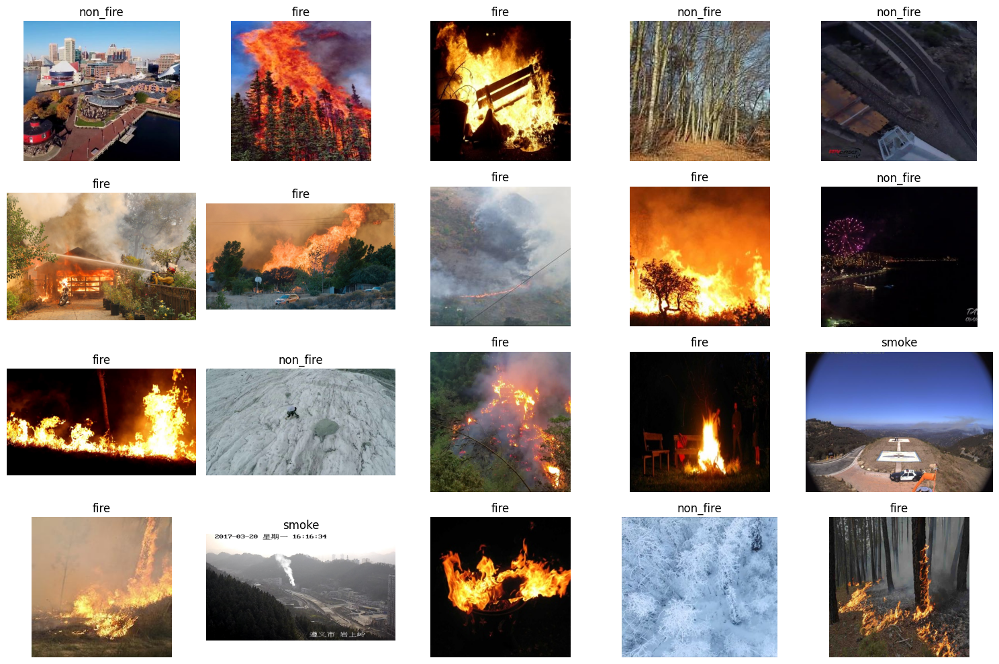

In [18]:
# Случайным образом выбираем 20 строк из DataFrame
sampled_data = df.sample(n=20, random_state=random.randint(1, 1000))

# Создаем график для отображения 20 изображений
fig, axes = plt.subplots(4, 5, figsize=(15, 10))  # 4 строки, 5 столбцов
axes = axes.flatten()  # Делаем массив плоским для итерации

# Отображаем изображения с заголовками class
for i, (index, row) in enumerate(sampled_data.iterrows()):
    # Декодируем изображение из base64
    image = decode_base64_to_image(row["image"])
    class_title = row["class"]  # Получаем значение из столбца class
    axes[i].imshow(image)
    axes[i].set_title(class_title)
    axes[i].axis("off")  # Убираем оси

# Убираем пустые подграфики, если их больше 20
for j in range(len(sampled_data), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


# EDA  (Exploratory Data Analysis)

Баланс классов:
class
fire        939
non_fire    929
smoke       530
Name: count, dtype: int64


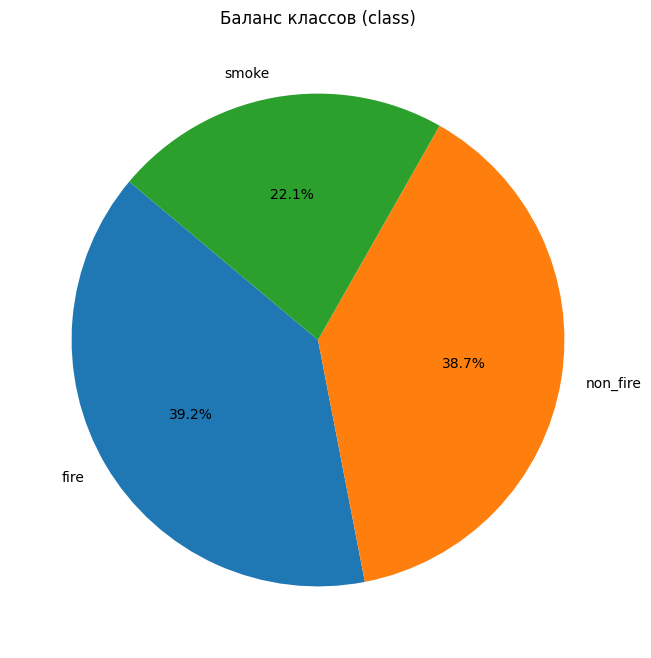

In [19]:
import matplotlib.pyplot as plt

# Подсчет количества объектов в каждом классе
class_counts = df["class"].value_counts()

# Вывод подсчитанных значений
print("Баланс классов:")
print(class_counts)

# Построение круговой диаграммы
plt.figure(figsize=(8, 8))
plt.pie(class_counts, labels=class_counts.index, autopct="%1.1f%%", startangle=140)
plt.title("Баланс классов (class)")
plt.show()


Вывод:

- данные хорошо сбалансированны

- достаточно будет рассмотреть метрику accuracy

Размеры изображений:
- Проверим распределение размеров изображений (ширина и высота). Для каждого класса раздельно.
- Построим scatter plot ширины и высоты изображений.



Диаграммы цветности, контрастности, яркости, цветности отдельно для каждого класса. Усредненные по всем изображениям.

1-я строка: Гистограммы цветности для fire и non_fire

2-я строка: Гистограммы контраста для fire и non_fire

3-я строка: Гистограммы яркости для fire и non_fire

4-я строка: Гистограммы резкости для fire и non_fire

In [20]:
import cv2

# Функция для декодирования изображений
def decode_base64_to_image(base64_str):
    decoded_bytes = base64.b64decode(base64_str)
    image = Image.open(BytesIO(decoded_bytes))
    return image

# Функция для вычисления гистограммы для RGB каналов
def calculate_average_rgb_histogram(images):
    hist_r = np.zeros(256)
    hist_g = np.zeros(256)
    hist_b = np.zeros(256)

    for image in images:
        rgb_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
        hist_r += cv2.calcHist([rgb_image], [2], None, [256], [0, 256]).flatten()
        hist_g += cv2.calcHist([rgb_image], [1], None, [256], [0, 256]).flatten()
        hist_b += cv2.calcHist([rgb_image], [0], None, [256], [0, 256]).flatten()

    hist_r /= len(images)
    hist_g /= len(images)
    hist_b /= len(images)
    return hist_r, hist_g, hist_b

# Функция для вычисления усреднённого контраста
def calculate_average_contrast_histogram(images):
    contrast_hist = np.zeros(256)
    for image in images:
        # Убедимся, что изображение имеет 3 канала
        if len(image.getbands()) == 1:  # Если изображение черно-белое
            image = image.convert("RGB")  # Преобразуем в RGB
        lab_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2Lab)
        luminance = lab_image[:, :, 0]
        hist = cv2.calcHist([luminance], [0], None, [256], [0, 256]).flatten()
        contrast_hist += hist
    contrast_hist /= len(images)
    return contrast_hist

# Функция для вычисления усреднённой яркости
def calculate_average_brightness(images):
    brightness = np.zeros(len(images))
    for i, image in enumerate(images):
        # Убедимся, что изображение имеет 3 канала
        if len(image.getbands()) == 1:  # Если изображение черно-белое
            image = image.convert("RGB")  # Преобразуем в RGB
        lab_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2Lab)
        brightness[i] = np.mean(lab_image[:, :, 0])  # Luminance channel
    return brightness

# Функция для вычисления усреднённой резкости
def calculate_average_sharpness(images):
    sharpness = np.zeros(len(images))
    for i, image in enumerate(images):
        # Убедимся, что изображение имеет 3 канала
        if len(image.getbands()) == 1:  # Если изображение черно-белое
            image = image.convert("RGB")  # Преобразуем в RGB
        gray_image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY)
        sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
        sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
        sharpness[i] = np.mean(np.sqrt(sobel_x**2 + sobel_y**2))
    return sharpness

# Получаем изображения по классам
fire_images = [decode_base64_to_image(row['image']) for _, row in df[df['class'] == 'fire'].iterrows()]
non_fire_images = [decode_base64_to_image(row['image']) for _, row in df[df['class'] == 'non_fire'].iterrows()]
smoke_images = [decode_base64_to_image(row['image']) for _, row in df[df['class'] == 'smoke'].iterrows()]

# Вычисляем усреднённые гистограммы для каждого класса
fire_rgb_hist = calculate_average_rgb_histogram(fire_images)
fire_contrast_hist = calculate_average_contrast_histogram(fire_images)
fire_brightness = calculate_average_brightness(fire_images)
fire_sharpness = calculate_average_sharpness(fire_images)

non_fire_rgb_hist = calculate_average_rgb_histogram(non_fire_images)
non_fire_contrast_hist = calculate_average_contrast_histogram(non_fire_images)
non_fire_brightness = calculate_average_brightness(non_fire_images)
non_fire_sharpness = calculate_average_sharpness(non_fire_images)

smoke_rgb_hist = calculate_average_rgb_histogram(smoke_images)
smoke_contrast_hist = calculate_average_contrast_histogram(smoke_images)
smoke_brightness = calculate_average_brightness(smoke_images)
smoke_sharpness = calculate_average_sharpness(smoke_images)

Перименовать тайтлы на русский

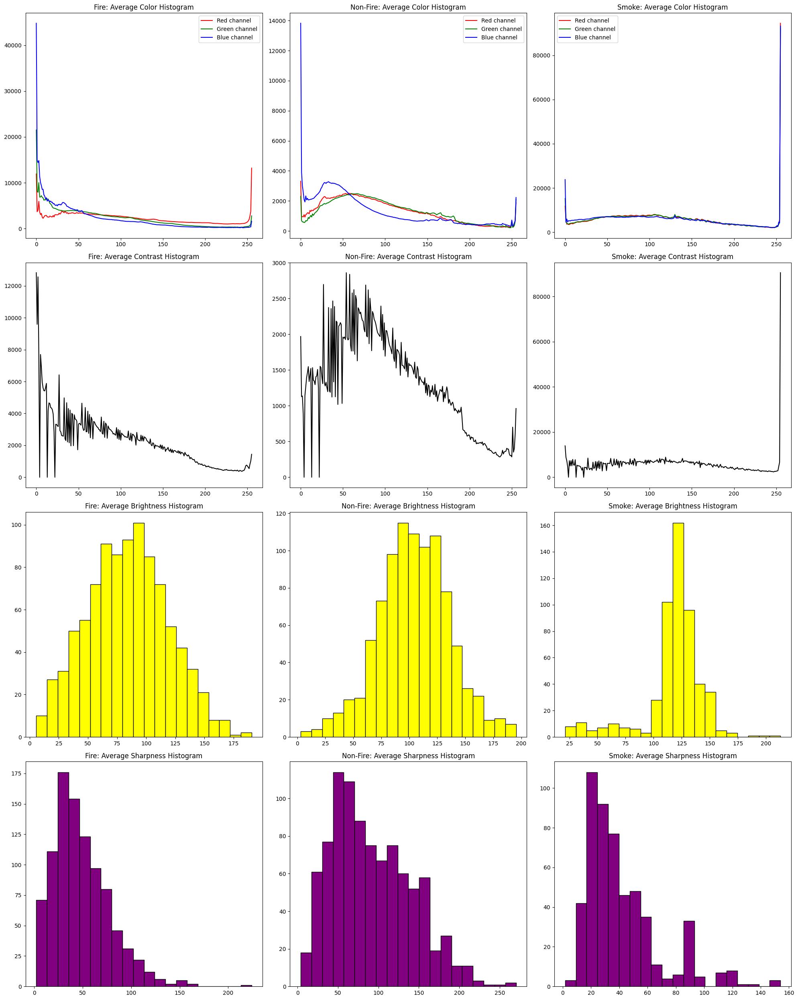

In [21]:
# Построение диаграмм
fig, axes = plt.subplots(4, 3, figsize=(20, 25))  # 4 строки, 3 столбца

# Гистограмма цветности
axes[0, 0].plot(fire_rgb_hist[0], color='red', label='Red channel')
axes[0, 0].plot(fire_rgb_hist[1], color='green', label='Green channel')
axes[0, 0].plot(fire_rgb_hist[2], color='blue', label='Blue channel')
axes[0, 0].set_title("Fire: Average Color Histogram")
axes[0, 0].legend()

axes[0, 1].plot(non_fire_rgb_hist[0], color='red', label='Red channel')
axes[0, 1].plot(non_fire_rgb_hist[1], color='green', label='Green channel')
axes[0, 1].plot(non_fire_rgb_hist[2], color='blue', label='Blue channel')
axes[0, 1].set_title("Non-Fire: Average Color Histogram")
axes[0, 1].legend()

axes[0, 2].plot(smoke_rgb_hist[0], color='red', label='Red channel')
axes[0, 2].plot(smoke_rgb_hist[1], color='green', label='Green channel')
axes[0, 2].plot(smoke_rgb_hist[2], color='blue', label='Blue channel')
axes[0, 2].set_title("Smoke: Average Color Histogram")
axes[0, 2].legend()

# Гистограмма контраста
axes[1, 0].plot(fire_contrast_hist, color='black', label='Contrast')
axes[1, 0].set_title("Fire: Average Contrast Histogram")

axes[1, 1].plot(non_fire_contrast_hist, color='black', label='Contrast')
axes[1, 1].set_title("Non-Fire: Average Contrast Histogram")

axes[1, 2].plot(smoke_contrast_hist, color='black', label='Contrast')
axes[1, 2].set_title("Smoke: Average Contrast Histogram")

# Гистограмма яркости
axes[2, 0].hist(fire_brightness, bins=20, color='yellow', edgecolor='black')
axes[2, 0].set_title("Fire: Average Brightness Histogram")

axes[2, 1].hist(non_fire_brightness, bins=20, color='yellow', edgecolor='black')
axes[2, 1].set_title("Non-Fire: Average Brightness Histogram")

axes[2, 2].hist(smoke_brightness, bins=20, color='yellow', edgecolor='black')
axes[2, 2].set_title("Smoke: Average Brightness Histogram")

# Гистограмма резкости
axes[3, 0].hist(fire_sharpness, bins=20, color='purple', edgecolor='black')
axes[3, 0].set_title("Fire: Average Sharpness Histogram")

axes[3, 1].hist(non_fire_sharpness, bins=20, color='purple', edgecolor='black')
axes[3, 1].set_title("Non-Fire: Average Sharpness Histogram")

axes[3, 2].hist(smoke_sharpness, bins=20, color='purple', edgecolor='black')
axes[3, 2].set_title("Smoke: Average Sharpness Histogram")

plt.tight_layout()
plt.show()

Вывод:

- классы хорошо различимы по таким характеристикам как цветность, контрастность и яркость.

- модель также , предположительно, хорошо сможет различить классы, что повлияет на метрику.

# Preprocessing

Разобъем датасет на обучающую и тестовую выборку с предварительным перемешиванием строк датасета:

In [22]:
from sklearn.model_selection import train_test_split

# Перемешивание строк в DataFrame
shuffled_df = df.sample(frac=1, random_state=42).reset_index(drop=True)

# Разделение на обучающую и тестовую выборки
train_df, test_df = train_test_split(shuffled_df, test_size=0.2, random_state=42)

# Вывод размеров полученных выборок
print(f"Размер обучающей выборки: {len(train_df)}")
print(f"Размер тестовой выборки: {len(test_df)}")

Размер обучающей выборки: 1918
Размер тестовой выборки: 480


In [23]:
import pandas as pd
import numpy as np


from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Handling paths

import time

from torchvision import transforms
import PIL.ImageOps


import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torchvision import models
from torchvision.datasets import ImageFolder
%pip install torchsummary -q
import torchsummary
from torchsummary import summary
import gc

from itertools import chain

from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import Dataset
from torch.utils.data import DataLoader


import torchvision
from torchvision import datasets, models, transforms, utils
from torchvision.transforms import v2

import cv2
import os
from glob import glob
from tqdm import tqdm
import shutil
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import confusion_matrix , accuracy_score, classification_report
import seaborn as sns

Note: you may need to restart the kernel to use updated packages.


In [24]:
train_transforms = v2.Compose([
    v2.Resize((288,288)),
    v2.AutoAugment(),
    v2.RandomResizedCrop(size=(288, 288), antialias=True),
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomVerticalFlip(p=0.4),
    v2.RandomRotation(degrees=(-10, 10)),
    v2.RandomAffine(degrees=(-10, 10), translate=(0.1, 0.1), scale=(0.9, 1.1)),
    v2.RandomErasing(p=0.4, scale=(0.1,0.15)),
    v2.PILToTensor(),
    v2.ToDtype(torch.float32),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),

])

test_transforms = v2.Compose([
    v2.Resize((288,288)),
    v2.PILToTensor(),
    v2.ToDtype(torch.float32),
    v2.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])
])

test_transforms_2 = v2.Compose([
    v2.Resize((288,288)),
    v2.PILToTensor(),
    v2.ToDtype(torch.float32),
#    v2.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])
])

In [25]:
from sklearn.preprocessing import LabelEncoder
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch
from PIL import Image
import base64
from io import BytesIO

# Функция для декодирования Base64 в изображение PIL
def decode_base64_to_image(base64_str):
    decoded_bytes = base64.b64decode(base64_str)
    image = Image.open(BytesIO(decoded_bytes)).convert('RGB')  # Преобразуем в RGB
    return image

# Определение кастомного датасета
class CustomDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform if transform else transforms.Compose([
            transforms.Resize((224, 224)),  # Изменяем размер изображений
            transforms.ToTensor()  # Преобразуем в тензор
        ])

        # Преобразуем строки меток в числовые значения
        self.label_encoder = LabelEncoder()
        self.dataframe['classTitle'] = self.label_encoder.fit_transform(self.dataframe['class'])

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        # Получаем изображение (в формате Base64) и метку
        base64_image = self.dataframe.iloc[idx]['image']
        label = self.dataframe.iloc[idx]['classTitle']

        # Декодируем изображение из Base64
        image = decode_base64_to_image(base64_image)

        # Преобразуем изображение с использованием трансформаций
        if self.transform:
            image = self.transform(image)

        # Преобразуем метку в тензор
        label = torch.tensor(label, dtype=torch.long)

        return image, label

# Пример создания DataLoader
train_dataset = CustomDataset(train_df)
test_dataset = CustomDataset(test_df)
test_dataset_2 = CustomDataset(test_df_2)
train_loader = DataLoader(train_dataset, batch_size=24, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=24, shuffle=True)
test_loader_2  = DataLoader(test_dataset_2, batch_size=24, shuffle=True)

# Процесс загрузки данных и проверки их формы
for images, labels in train_loader:
    print(f"Размер изображений в одном batch: {images.shape}")
    print(f"Количество меток в одном batch: {len(labels)}")
    break


Размер изображений в одном batch: torch.Size([24, 3, 224, 224])
Количество меток в одном batch: 24


In [26]:
print(f'train data:{len(train_df)}')
print(f'val data:{len(test_df)}')

train data:1918
val data:480


# Training Model

In [27]:
device = ""
if torch.cuda.is_available():
    print("используем GPU:", torch.cuda.get_device_name())
    device = "cuda"
else:
    print("используем CPU")
    device = "cpu"
num_workers = 2 if device=='cuda' else 4

используем CPU


In [28]:
%pip install timm -q
%pip install torchinfo -q

Note: you may need to restart the kernel to use updated packages.


Note: you may need to restart the kernel to use updated packages.


In [29]:
import timm

m = timm.create_model("rexnetr_300", pretrained = True, num_classes = 3)
def train_setup(m):
  return m.to(device), 20, device, torch.nn.CrossEntropyLoss(), torch.optim.Adam(params = m.parameters(), lr = 1e-4)
m, epochs, device, loss_fn, optimizer = train_setup(m)

In [30]:
#from torchsummary import summary
#m.to(device)
#summary(m, (3, 288, 288))

from torchinfo import summary

# Перемещаем модель на устройство (например, GPU)
m.to(device)

# Выводим информацию о модели с указанием batch_size
summary(m, input_size=(1, 3, 288, 288), device=device, col_width=20, col_names=["input_size", "output_size", "num_params"])

Layer (type:depth-idx)                        Input Shape          Output Shape         Param #
RexNet                                        [1, 3, 288, 288]     [1, 3]               --
├─ConvNormAct: 1-1                            [1, 3, 288, 288]     [1, 96, 144, 144]    --
│    └─Conv2d: 2-1                            [1, 3, 288, 288]     [1, 96, 144, 144]    2,592
│    └─BatchNormAct2d: 2-2                    [1, 96, 144, 144]    [1, 96, 144, 144]    192
│    │    └─Identity: 3-1                     [1, 96, 144, 144]    [1, 96, 144, 144]    --
│    │    └─SiLU: 3-2                         [1, 96, 144, 144]    [1, 96, 144, 144]    --
├─Sequential: 1-2                             [1, 96, 144, 144]    [1, 3840, 9, 9]      --
│    └─LinearBottleneck: 2-3                  [1, 96, 144, 144]    [1, 48, 144, 144]    --
│    │    └─ConvNormAct: 3-3                  [1, 96, 144, 144]    [1, 96, 144, 144]    1,056
│    │    └─ReLU6: 3-4                        [1, 96, 144, 144]    [1, 96, 144

In [31]:
def train(dataloader, model, loss_fn, optimizer, lr_scheduler):
    size = 0
    num_batches = len(dataloader) # batches per epoch
    model.train()
    epoch_loss = 0.0
    epoch_correct = 0
    for (data_,target_) in dataloader:
        target_ = target_.type(torch.LongTensor)
        data_, target_ = data_.to(device), target_.to(device)

        # First we'll clean the cache of optimizer
        optimizer.zero_grad()

        # Forward propagation
        outputs = model(data_)

        # Computing loss
        loss = loss_fn(outputs,target_)

        # Backward propagation
        loss.backward()

        # Optimizing model
        optimizer.step()

        # Computing statistics.
        epoch_loss = epoch_loss + loss.item()
        _,pred = torch.max(outputs,dim=1)
        epoch_correct = epoch_correct + torch.sum(pred == target_).item()
        size += target_.shape[0]
    lr_scheduler.step()
    return epoch_correct/size, epoch_loss/num_batches


def test(dataloader, model, loss_fn):
    # size = len(dataloader.dataset) # number of samples
    size = 0
    num_batches = len(dataloader) # batches per epoch
    epoch_loss = 0.0
    epoch_correct = 0
    with torch.no_grad():
        # This will disable backward propagation
        model.eval()
        for (data_,target_) in dataloader:
            target_ = target_.type(torch.LongTensor)
            data_, target_ = data_.to(device), target_.to(device)

            # Forward propagation
            outputs = model(data_)

            # Computing loss
            loss = loss_fn(outputs,target_)
            # Computing statistics.
            epoch_loss = epoch_loss + loss.item()
            _,pred = torch.max(outputs,dim=1)
            epoch_correct = epoch_correct + torch.sum(pred == target_).item()
            size += target_.shape[0]
    return  epoch_correct/size, epoch_loss/num_batches

In [32]:
model=m

In [34]:
t1 = time.perf_counter()
EPOCHS = 10

logs = {
    'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []
}

if os.path.exists('checkpoints') == False:
    os.mkdir("checkpoints")

criterion  = nn.CrossEntropyLoss()


# Optimizer which will use gradients to train model.
learning_rate = 0.0001
momentum = 0.9
weight_decay = 0.1
# optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate, betas=(0.9, 0.999), eps=1e-08, weight_decay=weight_decay, amsgrad=False)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
#optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
# optimizer = torch.optim.Adam(model.parameters(), lr=0.0007)
lr_milestones = [5, 15, 20, 25, 30]
multi_step_lr_scheduler = lr_scheduler.MultiStepLR(optimizer, milestones=lr_milestones, gamma=0.1)

# Earlystopping
patience = 6
counter = 0
best_loss = np.inf

for epoch in tqdm(range(EPOCHS)):
    train_acc, train_loss,  = train(train_loader, model, criterion, optimizer, multi_step_lr_scheduler)
    val_acc, val_loss = test(test_loader, model, criterion)
    print(f'EPOCH: {epoch} \
    train_loss: {train_loss:.4f}, train_acc: {train_acc:.3f} \
    val_loss: {val_loss:.4f}, val_acc: {val_acc:.3f} \
    lr: {optimizer.param_groups[0]["lr"]}')

    logs['train_loss'].append(train_loss)
    logs['train_acc'].append(train_acc)
    logs['val_loss'].append(val_loss)
    logs['val_acc'].append(val_acc)
    try:
        torch.save(model.state_dict(), "./hackathon/last.pth")
    except:    
        torch.save(model.state_dict(), "/content/drive/MyDrive/hackathon/last.pth")

    # chcek improvement
    if val_loss < best_loss:
        counter = 0
        best_loss = val_loss
        try:
            torch.save(model.state_dict(), "./hackathon/best.pth")
        except:  
            torch.save(model.state_dict(), "/content/drive/MyDrive/hackathon/best.pth")
    else:
        counter += 1
    if counter >= patience:
        print("Earlystop!")
        break

t2 = time.perf_counter()
print('время обучения, мин:',(t2-t1)/60)

  0%|          | 0/10 [00:00<?, ?it/s]

EPOCH: 0     train_loss: 0.4875, train_acc: 0.912     val_loss: 0.2752, val_acc: 0.931     lr: 0.0001


 20%|██        | 2/10 [21:43<1:26:53, 651.72s/it]

EPOCH: 1     train_loss: 0.2623, train_acc: 0.946     val_loss: 0.3083, val_acc: 0.933     lr: 0.0001


 30%|███       | 3/10 [32:32<1:15:53, 650.47s/it]

EPOCH: 2     train_loss: 0.3628, train_acc: 0.933     val_loss: 0.7617, val_acc: 0.898     lr: 0.0001
EPOCH: 3     train_loss: 0.3096, train_acc: 0.939     val_loss: 0.1351, val_acc: 0.965     lr: 0.0001


 50%|█████     | 5/10 [54:04<54:00, 648.07s/it]  

EPOCH: 4     train_loss: 0.1502, train_acc: 0.958     val_loss: 0.2791, val_acc: 0.944     lr: 1e-05


 60%|██████    | 6/10 [1:04:47<43:05, 646.34s/it]

EPOCH: 5     train_loss: 0.0821, train_acc: 0.978     val_loss: 0.2117, val_acc: 0.960     lr: 1e-05


 70%|███████   | 7/10 [1:15:31<32:16, 645.56s/it]

EPOCH: 6     train_loss: 0.0333, train_acc: 0.992     val_loss: 0.1879, val_acc: 0.963     lr: 1e-05


 80%|████████  | 8/10 [1:26:10<21:26, 643.48s/it]

EPOCH: 7     train_loss: 0.0382, train_acc: 0.991     val_loss: 0.1689, val_acc: 0.969     lr: 1e-05


 90%|█████████ | 9/10 [1:36:54<10:43, 643.54s/it]

EPOCH: 8     train_loss: 0.0170, train_acc: 0.995     val_loss: 0.1891, val_acc: 0.963     lr: 1e-05


 90%|█████████ | 9/10 [1:47:33<11:57, 717.08s/it]

EPOCH: 9     train_loss: 0.0120, train_acc: 0.996     val_loss: 0.1995, val_acc: 0.967     lr: 1e-05
Earlystop!
время обучения, мин: 107.56160718166666


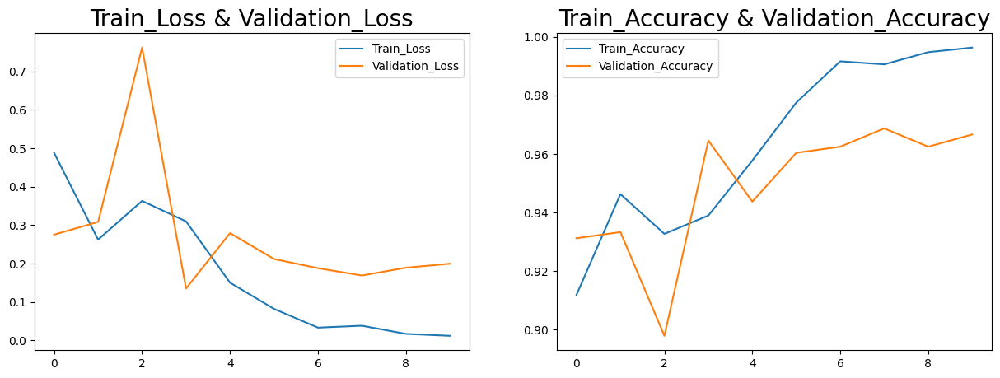

In [35]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(logs['train_loss'],label='Train_Loss')
plt.plot(logs['val_loss'],label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(1,2,2)
plt.plot(logs['train_acc'],label='Train_Accuracy')
plt.plot(logs['val_acc'],label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()

# Exploring Predictions

In [36]:
pthfile = r'/content/drive/MyDrive/hackathon/best.pth'
pthfile_home = r'./hackathon/best.pth'
try:
    net = torch.load (pthfile_home)
except:
    net = torch.load (pthfile)#, map_location = torch.device ('cuda')) # Поскольку модель изначально была сохранена с графическим процессором, но у меня нет графического процессора на этом компьютере, мне нужно преобразовать ее в центральный процессор

#print (type (net)) # Тип является dict
#print (len (net)) # Длина равна 4, то есть есть четыре пары ключ-значение

#for k in net.keys():
#         print (k) # Просмотр четырех ключей, а именно модели, оптимизатора, планировщика, итерации
         
# Вывод информации о загруженном объекте
print(f"Тип загруженного объекта: {type(net)}")
print(f"Количество ключей в словаре: {len(net)}")

# Вывод ключей и их типов
print("\nКлючи в загруженном словаре:")
for k in net.keys():
    print(f"  - Ключ: {k}, Тип: {type(net[k])}")

# Если есть ключ 'model', выводим информацию о модели
if 'model' in net:
    print("\nИнформация о модели:")
    model = net['model']
    print(f"  - Тип модели: {type(model)}")
    print(f"  - Архитектура модели: {model}")

# Если есть ключ 'optimizer', выводим информацию об оптимизаторе
if 'optimizer' in net:
    print("\nИнформация об оптимизаторе:")
    optimizer = net['optimizer']
    print(f"  - Тип оптимизатора: {type(optimizer)}")
    print(f"  - Состояние оптимизатора: {optimizer}")

# Если есть ключ 'scheduler', выводим информацию о планировщике
if 'scheduler' in net:
    print("\nИнформация о планировщике:")
    scheduler = net['scheduler']
    print(f"  - Тип планировщика: {type(scheduler)}")
    print(f"  - Состояние планировщика: {scheduler}")

# Если есть ключ 'iteration', выводим информацию об итерации
if 'iteration' in net:
    print("\nИнформация об итерации:")
    iteration = net['iteration']
    print(f"  - Итерация: {iteration}")

Тип загруженного объекта: <class 'collections.OrderedDict'>
Количество ключей в словаре: 413

Ключи в загруженном словаре:
  - Ключ: stem.conv.weight, Тип: <class 'torch.Tensor'>
  - Ключ: stem.bn.weight, Тип: <class 'torch.Tensor'>
  - Ключ: stem.bn.bias, Тип: <class 'torch.Tensor'>
  - Ключ: stem.bn.running_mean, Тип: <class 'torch.Tensor'>
  - Ключ: stem.bn.running_var, Тип: <class 'torch.Tensor'>
  - Ключ: stem.bn.num_batches_tracked, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.conv.weight, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.bn.weight, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.bn.bias, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.bn.running_mean, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.bn.running_var, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_dw.bn.num_batches_tracked, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_pwl.conv.weight, Тип: <class 'torch.Tensor'>
  - Ключ: features.0.conv_

model.load_state_dict(torch.load('/content/drive/MyDrive/hackathon/best.pth'))
model.eval()
y_true, y_pred = [], []

with torch.no_grad():
    for (data_,target_) in tqdm(test_loader):
        target_ = target_.type(torch.LongTensor)
        data_, target_ = data_.to(device), target_.to(device)
        outputs = model(data_)
        _,pred = torch.max(outputs,dim=1)
        y_true.extend(target_.cpu().numpy())
        y_pred.extend(pred.cpu().numpy())
y_pred = np.array(y_pred)
y_true = np.array(y_true)

100%|██████████| 20/20 [00:48<00:00,  2.43s/it]


Примеры предсказаний:
Sample 1:
True Label: smoke
Predicted Label: smoke
Class Probabilities: {'fire': 4.4827926e-11, 'smoke': 1.0, 'non_fire': 1.8200028e-09}
--------------------------------------------------
Sample 2:
True Label: non_fire
Predicted Label: non_fire
Class Probabilities: {'fire': 1.327013e-11, 'smoke': 3.3162454e-08, 'non_fire': 1.0}
--------------------------------------------------
Sample 3:
True Label: non_fire
Predicted Label: non_fire
Class Probabilities: {'fire': 4.2014017e-28, 'smoke': 2.659327e-30, 'non_fire': 1.0}
--------------------------------------------------
Sample 4:
True Label: fire
Predicted Label: fire
Class Probabilities: {'fire': 1.0, 'smoke': 1.479067e-10, 'non_fire': 8.572391e-14}
--------------------------------------------------
Sample 5:
True Label: smoke
Predicted Label: smoke
Class Probabilities: {'fire': 6.0814176e-09, 'smoke': 0.9999999, 'non_fire': 7.9435985e-08}
--------------------------------------------------
Sample 6:
True Label: fire

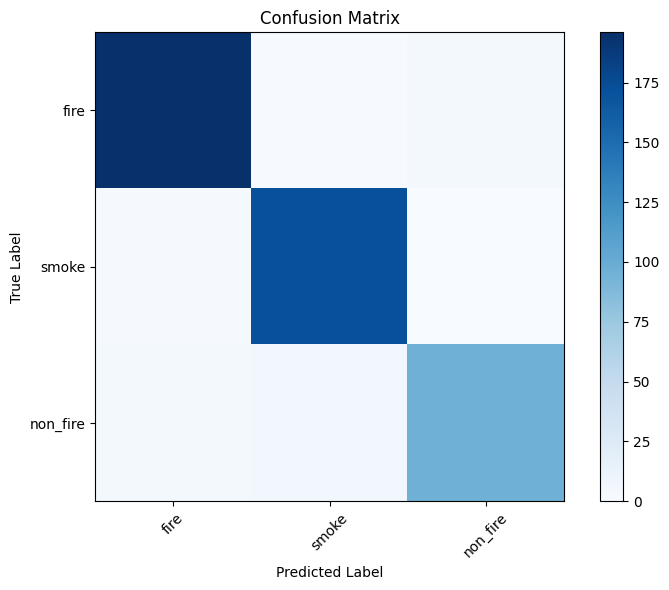


Визуализация вероятностей для 5 случайных примеров:


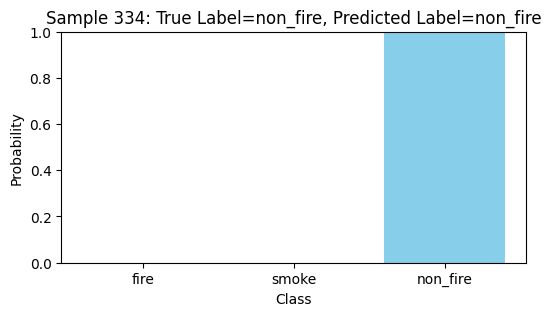

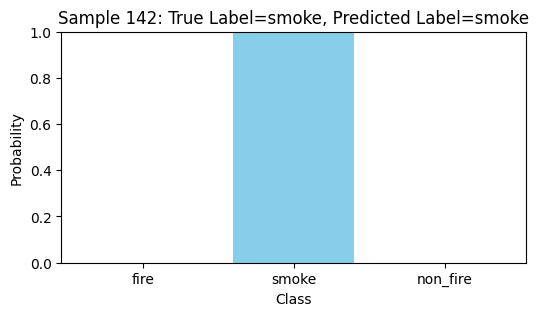

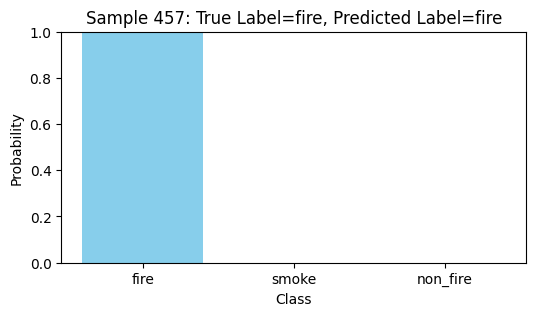

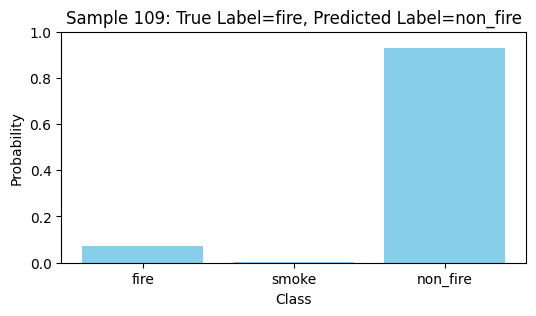

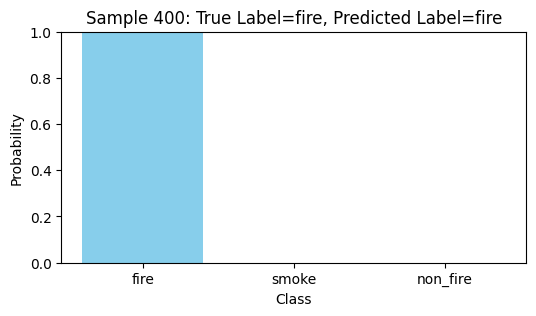

In [38]:
from sklearn.metrics import confusion_matrix, classification_report

# Тестирование модели с выводом вероятностей классов
y_true, y_pred, y_probs = [], [], []

with torch.no_grad():
    for (data_, target_) in tqdm(test_loader):
        target_ = target_.type(torch.LongTensor)
        data_, target_ = data_.to(device), target_.to(device)
        outputs = model(data_)
        probas = torch.softmax(outputs, dim=1)  # Применение softmax для получения вероятностей
        _, pred = torch.max(outputs, dim=1)
        y_true.extend(target_.cpu().numpy())
        y_pred.extend(pred.cpu().numpy())
        y_probs.extend(probas.cpu().numpy())

y_pred = np.array(y_pred)
y_true = np.array(y_true)
y_probs = np.array(y_probs)

target_names = ['fire', 'smoke', 'non_fire']

# Вывод вероятностей для каждого класса
print("Примеры предсказаний:")
for i, (true_label, pred_label, probs) in enumerate(zip(y_true, y_pred, y_probs)):
    print(f"Sample {i + 1}:")
    print(f"True Label: {target_names[true_label]}")
    print(f"Predicted Label: {target_names[pred_label]}")
    print(f"Class Probabilities: {dict(zip(target_names, probs))}")
    print("-" * 50)

# Вывод отчета о классификации
print("\nОтчет о классификации:")
print(classification_report(y_true, y_pred, target_names=target_names))

# Вывод матрицы ошибок
conf_matrix = confusion_matrix(y_true, y_pred)
print("\nМатрица ошибок:")
print(conf_matrix)

# Визуализация матрицы ошибок
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
tick_marks = np.arange(len(target_names))
plt.xticks(tick_marks, target_names, rotation=45)
plt.yticks(tick_marks, target_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.tight_layout()
plt.show()

# Визуализация вероятностей для нескольких примеров
num_samples_to_visualize = 5
print(f"\nВизуализация вероятностей для {num_samples_to_visualize} случайных примеров:")
for i in np.random.choice(len(y_true), num_samples_to_visualize, replace=False):
    true_label = target_names[y_true[i]]
    pred_label = target_names[y_pred[i]]
    probs = y_probs[i]

    plt.figure(figsize=(6, 3))
    plt.bar(target_names, probs, color='skyblue')
    plt.title(f"Sample {i + 1}: True Label={true_label}, Predicted Label={pred_label}")
    plt.xlabel("Class")
    plt.ylabel("Probability")
    plt.ylim(0, 1)
    plt.show()

In [39]:
from sklearn.metrics import classification_report

# Генерация отчета о классификации
clf_report = classification_report(y_true, y_pred, target_names=target_names)
print(clf_report)


              precision    recall  f1-score   support

        fire       0.97      0.98      0.97       201
       smoke       0.97      0.99      0.98       174
    non_fire       0.96      0.91      0.94       105

    accuracy                           0.97       480
   macro avg       0.97      0.96      0.96       480
weighted avg       0.97      0.97      0.97       480



In [40]:
Acc = accuracy_score(y_true,y_pred)
print("accuracy is: {0:.3f}%".format(Acc * 100))

accuracy is: 96.667%


# Применяем модель к произвольным фотографиям ( на тестововом датафрейме)

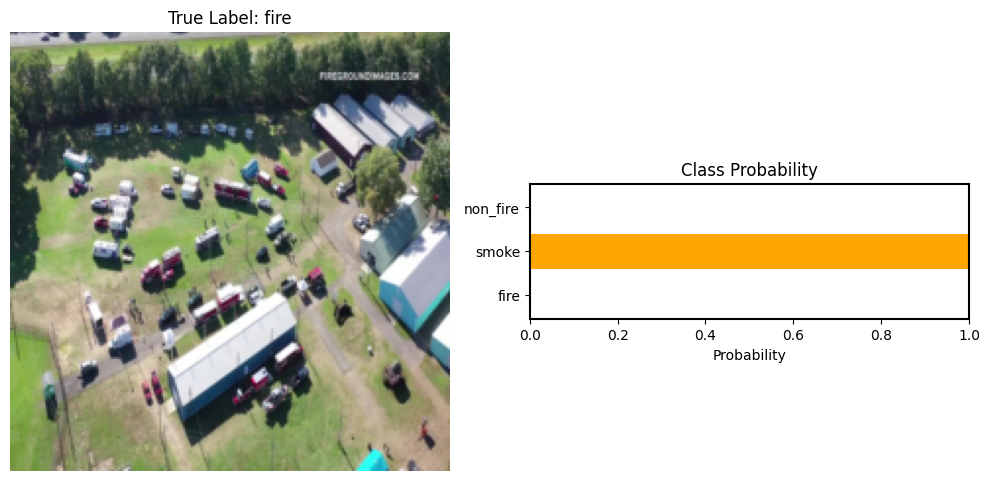

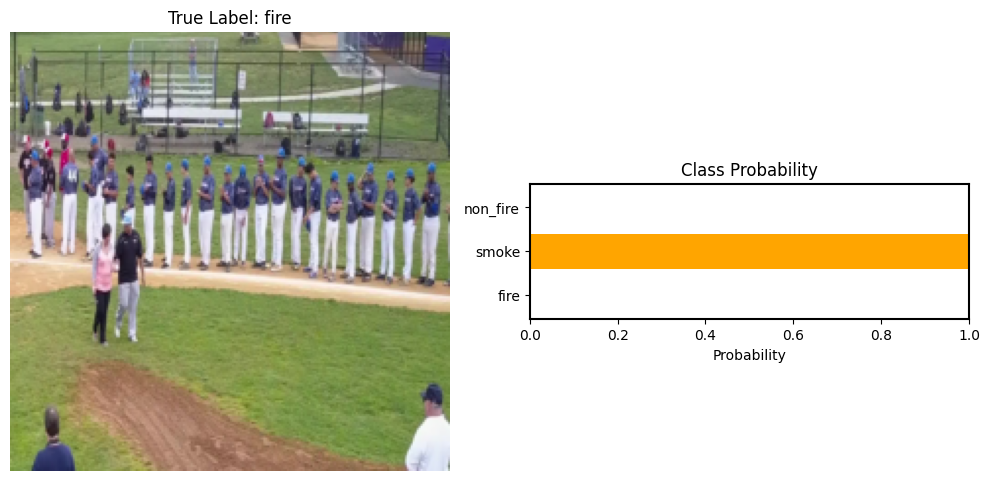

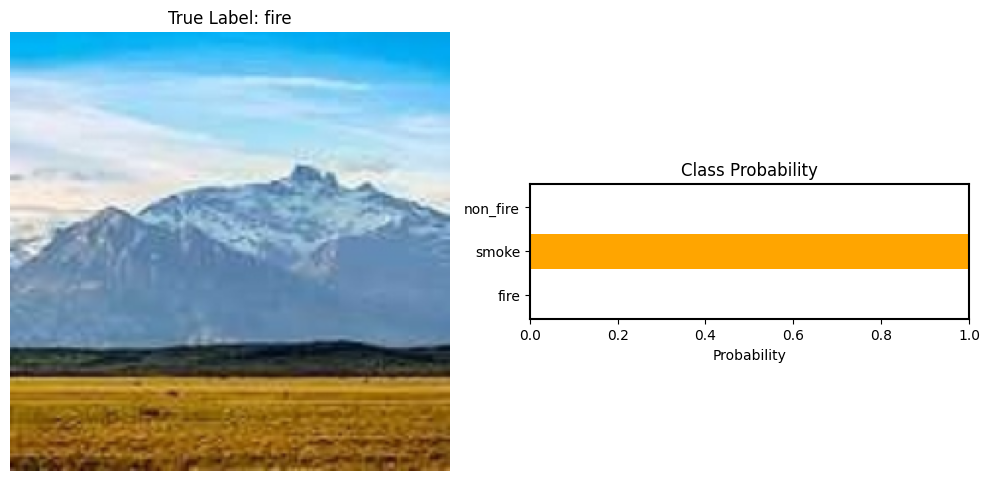

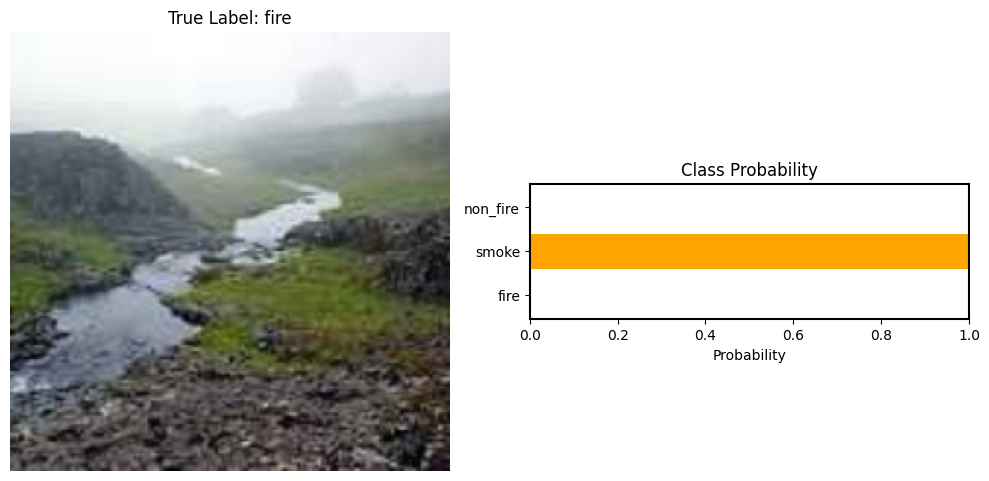

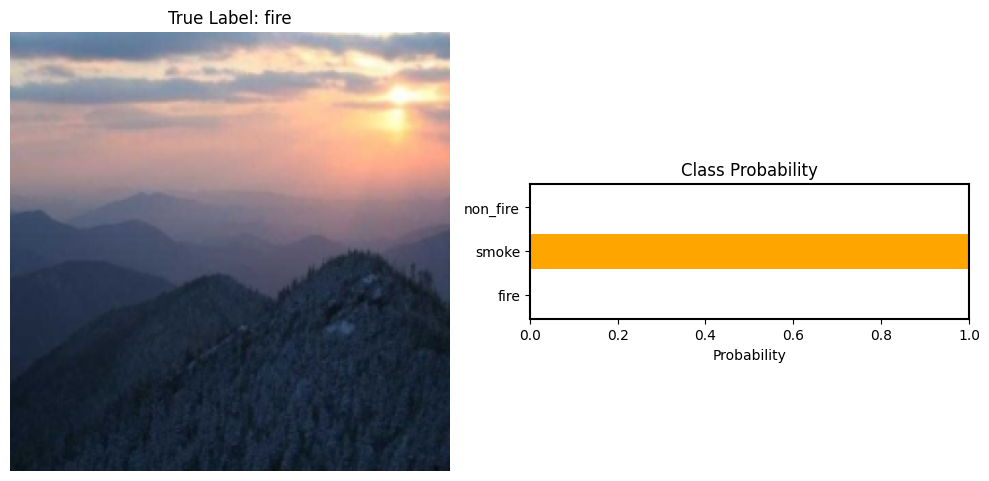

...

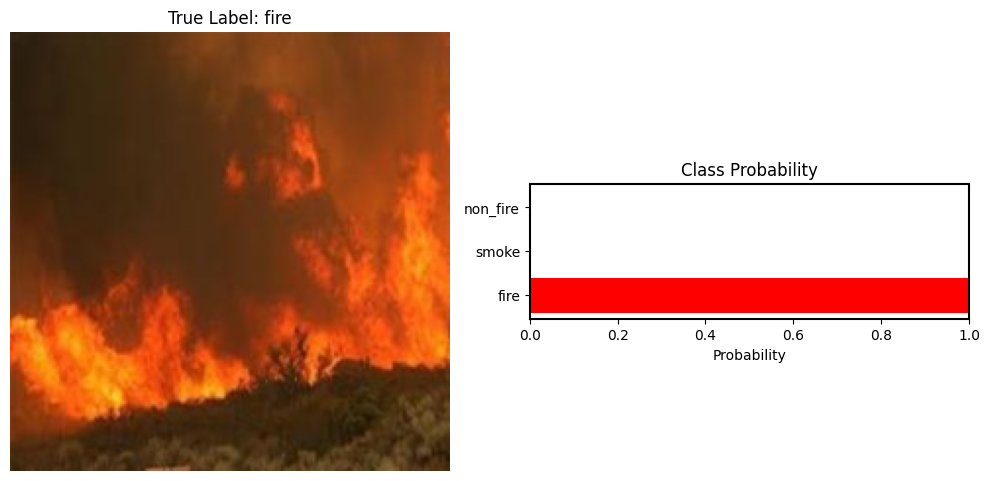

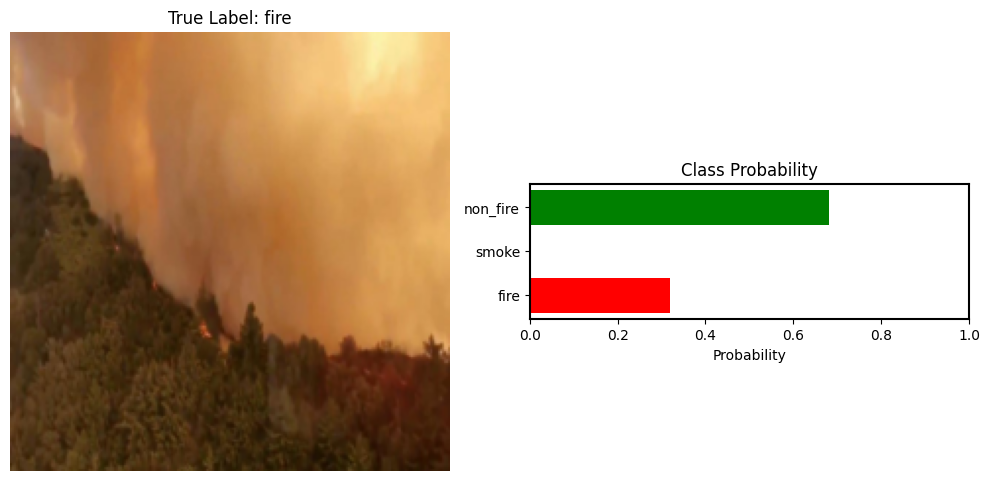

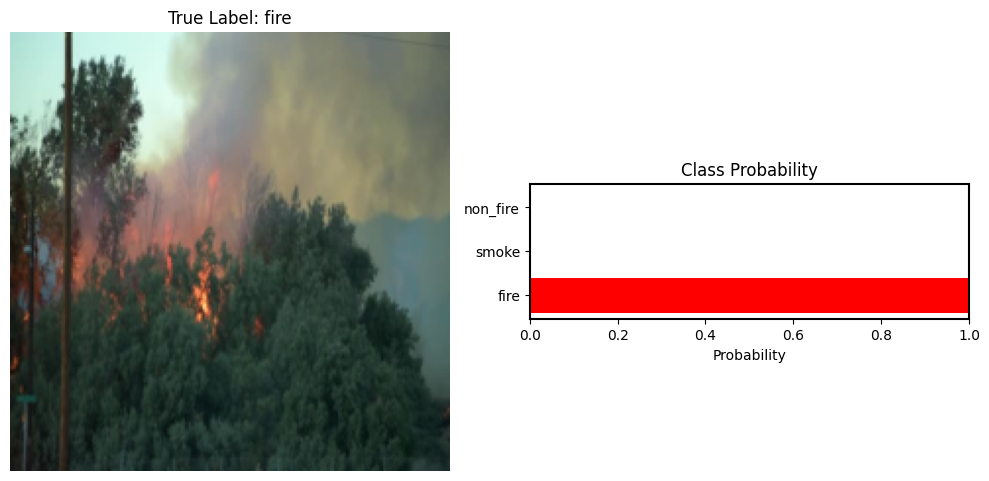

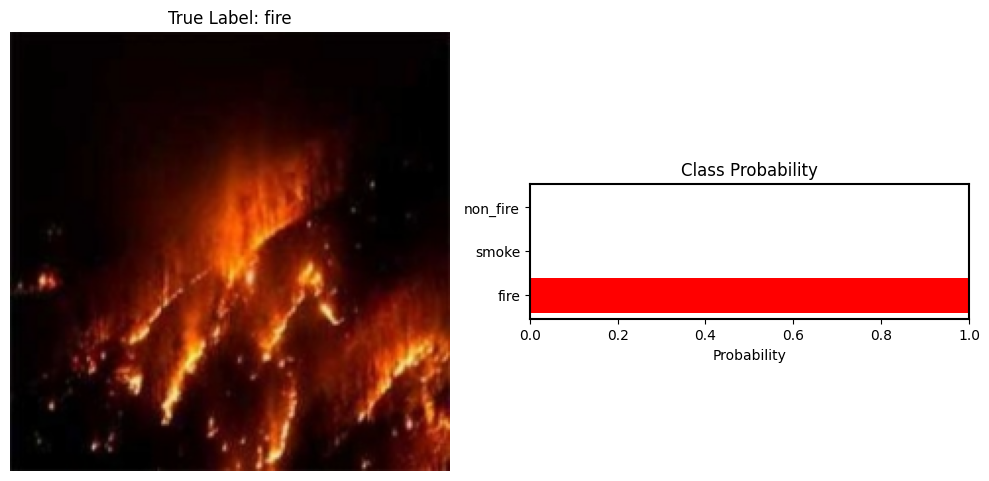

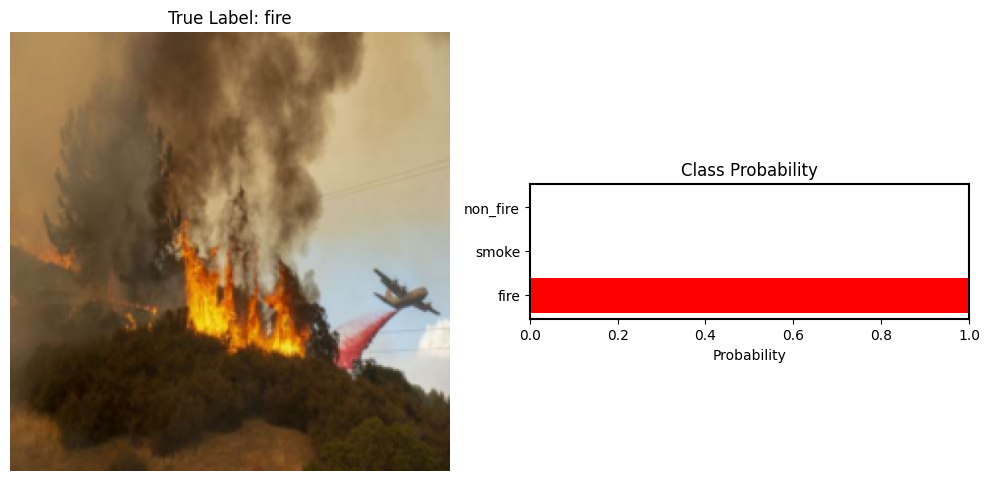

In [41]:
import torch
from torchvision import transforms

# Список классов
classes = ['fire', 'smoke', 'non_fire']

# Функция для визуализации
def visualize_predictions(test_dataset, model, device, num_samples=5):
    """
    Визуализация предсказаний модели для нескольких примеров.

    :param test_dataset: Датасет для тестирования.
    :param model: Обученная модель.
    :param device: Устройство (CPU или GPU).
    :param num_samples: Количество примеров для визуализации.
    """
    for i in range(num_samples):
        image, label = test_dataset[i]
        image = image.unsqueeze(0)  # Добавляем размерность для батча
        logits = model(image.to(device))  # Получаем логиты
        probs = torch.nn.Softmax(dim=1)(logits)  # Преобразуем логиты в вероятности
        probs = probs.data.cpu().numpy().squeeze()  # Преобразуем в numpy

        # Создаем подграфики
        fig, (ax1, ax2) = plt.subplots(figsize=(10, 5), ncols=2)

        # Визуализация изображения
        unloader = transforms.ToPILImage(mode='RGB')
        image = image.cpu().clone().squeeze(0)  # Убираем лишнюю размерность
        img = unloader(image)
        ax1.imshow(img)
        ax1.axis('off')
        ax1.set_title(f"True Label: {classes[label]}")

        # Визуализация вероятностей
        ax2.barh(classes, probs, color=['red', 'orange', 'green'])
        ax2.set_aspect(0.1)
        ax2.set_yticks(range(len(classes)))
        ax2.set_yticklabels(classes)
        ax2.set_title('Class Probability')
        ax2.set_xlabel('Probability')
        ax2.set_xlim(0, 1)  # Устанавливаем диапазон оси X от 0 до 1

        # Добавляем рамку вокруг графика
        for spine in ax2.spines.values():
            spine.set_edgecolor('black')
            spine.set_linewidth(1.5)

        plt.tight_layout()
        plt.show()

# Пример использования
visualize_predictions(test_dataset_2, model, device, num_samples=25)